<a href="https://colab.research.google.com/github/boramkim0514/KOIPA_AI/blob/main/D55_08_YOLO_Basic.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# YOLO : You Only Look Once
**Realtime Object Detection**

* SSD : Single Shot multibox Detector
  * 한번에 여러 박스를 찾아주는 개념
  * SSD의 대표 방식이 **YOLO**
* IoU : Intersection over Union
<img src="https://pyimagesearch.com/wp-content/uploads/2016/09/iou_equation.png" width="300">






In [ ]:
from google.colab import drive
drive.mount("/gdrive")

Mounted at /gdrive


In [ ]:
!ls -al '/gdrive/MyDrive/open_cv/darknet'

total 252586
drwx------ 2 root root      4096 Jul 21 03:50 backup
drwx------ 2 root root      4096 Jul 21 03:50 bin
drwx------ 2 root root      4096 Jul 21 03:50 cfg
drwx------ 2 root root      4096 Jul 21 03:50 custom
drwx------ 2 root root      4096 Jul 21 03:50 data
drwx------ 2 root root      4096 Jul 21 03:50 images
drwx------ 2 root root      4096 Jul 21 03:50 trafficsign
-rw------- 1 root root 258615009 Mar 18 02:18 Train.zip
drwx------ 2 root root      4096 Jul 21 03:50 weights


In [ ]:
# YOLO_WEIGHT_FILE = '/gdrive/MyDrive/open_cv/darknet/weights/yolov3.weights'
# YOLO_CFG_FILE = '/gdrive/MyDrive/open_cv/darknet/cfg/yolov3.cfg'
# YOLO_NAME_FILE = '/gdrive/My Drive/open_cv/darknet/data/coco.names'

In [ ]:
YOLO_WEIGHT_FILE = '/gdrive/My Drive/open_cv/darknet/weights/yolov3.weights' # 가중치
YOLO_CFG_FILE    = '/gdrive/My Drive/open_cv/darknet/cfg/yolov3.cfg'         # 모델 설정 파일(굿)
YOLO_NAME_FILE   = '/gdrive/My Drive/open_cv/darknet/data/coco.names'

#YOLO Image Detection

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

In [ ]:
min_confidence = 0.5

In [ ]:
#Load YOLO
net = cv2.dnn.readNet(
    YOLO_WEIGHT_FILE,
    YOLO_CFG_FILE
) #CGF_FILE을 이용해서 네트워크를 구축하고, WEIGHT_FILE을 이용해서 각종 가중치, 편향을 초기화 
net

<dnn_Net 0x7f9ce226db10>

In [ ]:
# Load COCO Classes
classes = []

with open(YOLO_NAME_FILE, 'r') as f:
    classes = [line.strip() for line in f.readlines() ]
print(classes)

['person', 'bicycle', 'car', 'motorbike', 'aeroplane', 'bus', 'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'sofa', 'pottedplant', 'bed', 'diningtable', 'toilet', 'tvmonitor', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush']


In [ ]:
# 출력 레이어 알아내기
# WEIGHTS를 로딩하면서 output 레이어가 분류할 수 있는 가중치까지 전부다 입력이 되었음
# 입력은 입력층에서 받되 계산은 output 레이어에서만 해도 된다
# 입력은 입력 대로, 출력은 내가 원하는 시점에서 할 수 있게

In [ ]:
output_layers = net.getUnconnectedOutLayersNames()
output_layers

['yolo_82', 'yolo_94', 'yolo_106']

In [ ]:
# 전체 레이어 이름
layer_names = net.getLayerNames()
layer_names

['conv_0',
 'bn_0',
 'relu_0',
 'conv_1',
 'bn_1',
 'relu_1',
 'conv_2',
 'bn_2',
 'relu_2',
 'conv_3',
 'bn_3',
 'relu_3',
 'shortcut_4',
 'conv_5',
 'bn_5',
 'relu_5',
 'conv_6',
 'bn_6',
 'relu_6',
 'conv_7',
 'bn_7',
 'relu_7',
 'shortcut_8',
 'conv_9',
 'bn_9',
 'relu_9',
 'conv_10',
 'bn_10',
 'relu_10',
 'shortcut_11',
 'conv_12',
 'bn_12',
 'relu_12',
 'conv_13',
 'bn_13',
 'relu_13',
 'conv_14',
 'bn_14',
 'relu_14',
 'shortcut_15',
 'conv_16',
 'bn_16',
 'relu_16',
 'conv_17',
 'bn_17',
 'relu_17',
 'shortcut_18',
 'conv_19',
 'bn_19',
 'relu_19',
 'conv_20',
 'bn_20',
 'relu_20',
 'shortcut_21',
 'conv_22',
 'bn_22',
 'relu_22',
 'conv_23',
 'bn_23',
 'relu_23',
 'shortcut_24',
 'conv_25',
 'bn_25',
 'relu_25',
 'conv_26',
 'bn_26',
 'relu_26',
 'shortcut_27',
 'conv_28',
 'bn_28',
 'relu_28',
 'conv_29',
 'bn_29',
 'relu_29',
 'shortcut_30',
 'conv_31',
 'bn_31',
 'relu_31',
 'conv_32',
 'bn_32',
 'relu_32',
 'shortcut_33',
 'conv_34',
 'bn_34',
 'relu_34',
 'conv_35',
 'bn

In [ ]:
#random color 만들기 
colors = np.random.uniform(0, 255, size=(len(classes), 3)) #랜덤한 3채널의 값 만들기

### 2. Upload Images

In [ ]:
from google.colab import files
files.upload()

Saving car1.jpg to car1.jpg


{'car1.jpg': b'\xff\xd8\xff\xfe\x00\x10Lavc56.60.100\x00\xff\xdb\x00C\x00\x08\x10\x10\x13\x10\x13\x16\x16\x16\x16\x16\x16\x1a\x18\x1a\x1b\x1b\x1b\x1a\x1a\x1a\x1a\x1b\x1b\x1b\x1d\x1d\x1d"""\x1d\x1d\x1d\x1b\x1b\x1d\x1d  ""%&%##"#&&(((00..88:EES\xff\xc4\x01\xa2\x00\x00\x01\x05\x01\x01\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x01\x02\x03\x04\x05\x06\x07\x08\t\n\x0b\x01\x00\x03\x01\x01\x01\x01\x01\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x01\x02\x03\x04\x05\x06\x07\x08\t\n\x0b\x10\x00\x02\x01\x03\x03\x02\x04\x03\x05\x05\x04\x04\x00\x00\x01}\x01\x02\x03\x00\x04\x11\x05\x12!1A\x06\x13Qa\x07"q\x142\x81\x91\xa1\x08#B\xb1\xc1\x15R\xd1\xf0$3br\x82\t\n\x16\x17\x18\x19\x1a%&\'()*456789:CDEFGHIJSTUVWXYZcdefghijstuvwxyz\x83\x84\x85\x86\x87\x88\x89\x8a\x92\x93\x94\x95\x96\x97\x98\x99\x9a\xa2\xa3\xa4\xa5\xa6\xa7\xa8\xa9\xaa\xb2\xb3\xb4\xb5\xb6\xb7\xb8\xb9\xba\xc2\xc3\xc4\xc5\xc6\xc7\xc8\xc9\xca\xd2\xd3\xd4\xd5\xd6\xd7\xd8\xd9\xda\xe1\xe2\xe3\xe4\xe5\xe6\xe7\xe8\xe9\xea\xf1\xf2\xf3\xf4\xf5\xf6\xf7

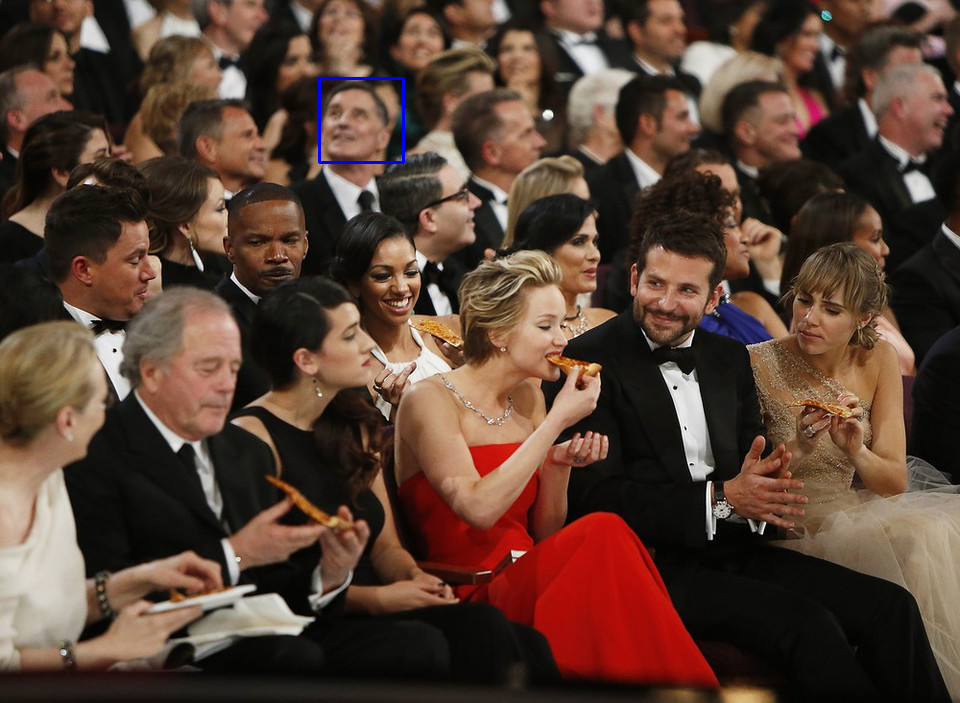

In [ ]:
file_name = "aud.png"

img = cv2.imread(file_name)
height, width, channels = img.shape

cv2_imshow(img)

In [ ]:
# yolo-416 config
blob = cv2.dnn.blobFromImage(
    img, 
    scalefactor=1/255.0,  # 픽셀값 정규화 중요!! 
    size=(416, 416), #중요!!
    mean=(0, 0, 0), #    mean=(0, 0, 0), #mean subtraction은 안해도 됨 선택적으로 해줘도 됨

    swapRB=True, #BRG 2 RGB
    crop=False, #optional choice
)

In [ ]:
net.setInput(blob)
outs = net.forward(output_layers)

In [ ]:
len(outs)

3

##3. Image Detection and Draw Boxes

In [ ]:
# class_ids = []
# confidences = []
# boxes = []

# for out in outs: # 3개의 레이어에 대한 분류 결과가 들ㅇ있다. 
#     for detection in out: # 각 레이어에서 탐색한 정보
#         # detection[0, 1, 2, 3] -> [center_x, center_y, width, height]
#         # detection[5: ]# softmax분류의 결과 - confidence 정보가 된다
#         scores = detection[5:]
#         class_id = np.argmax(scores) #가장 높은 곳의 인덱스가 classes의 id가 된다.

#         confidence = scores[class_id] #해당 클래스의 confidence 값
#         if confidence > min_confidence:
#             #print(class_id, confidence)

#             center_x = int(detection[0] * width)
#             center_y = int(detection[1] * height)

#             w = int(detection[2] * width)
#             h = int(detection[3] * height)

#             #Rectagle Coordinates
#             x= int(center_x - w / 2)
#             y = int(center_y - h / 2)


#             #클래스 별 사각형 좌표, confidence, id 모으기
#             boxes.append([x, y, w, h])
#             confidences.append(confidence.astype('float'))
#             class_ids.append(class_id)

#         #NMS : None Maximum Suppression

#         #탐지된 여러 개의 박스 중 하나만 선택된 것을 리턴
#         indexes = cv2.dnn.NMSBoxes(boxes, #감지된 박스 좌표
#                                    confidences, #감지된 박스의 confidence
#                                    min_confidence, #최소 confidence
#                                    0.4) #IoU 가 0.4이상인 것만 같은 박스로 치겠다는 뜻

#         indexes

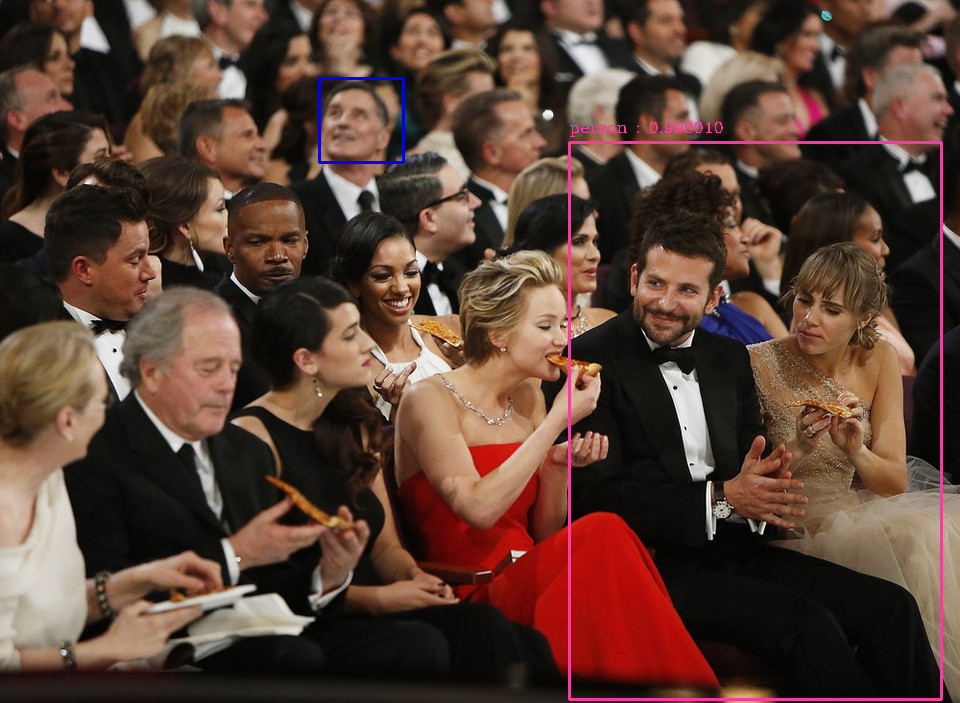

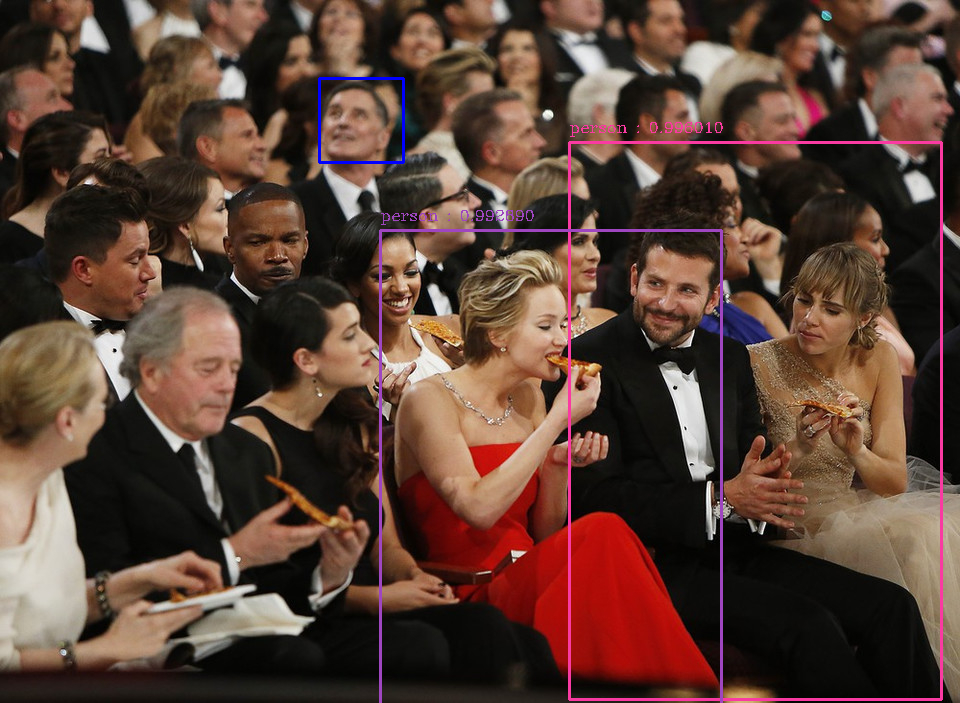

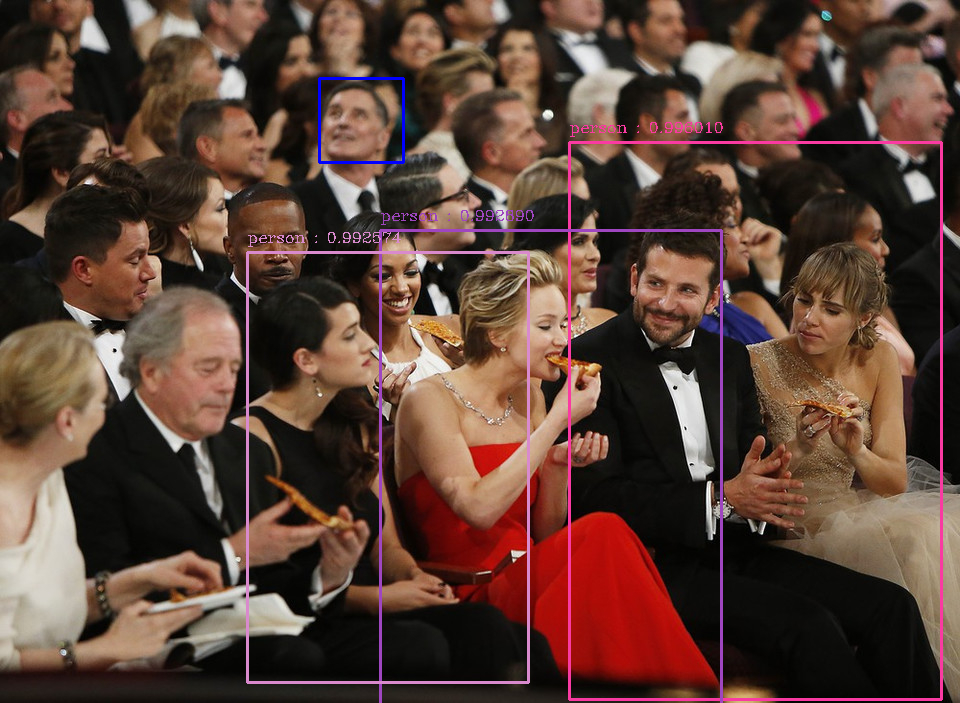

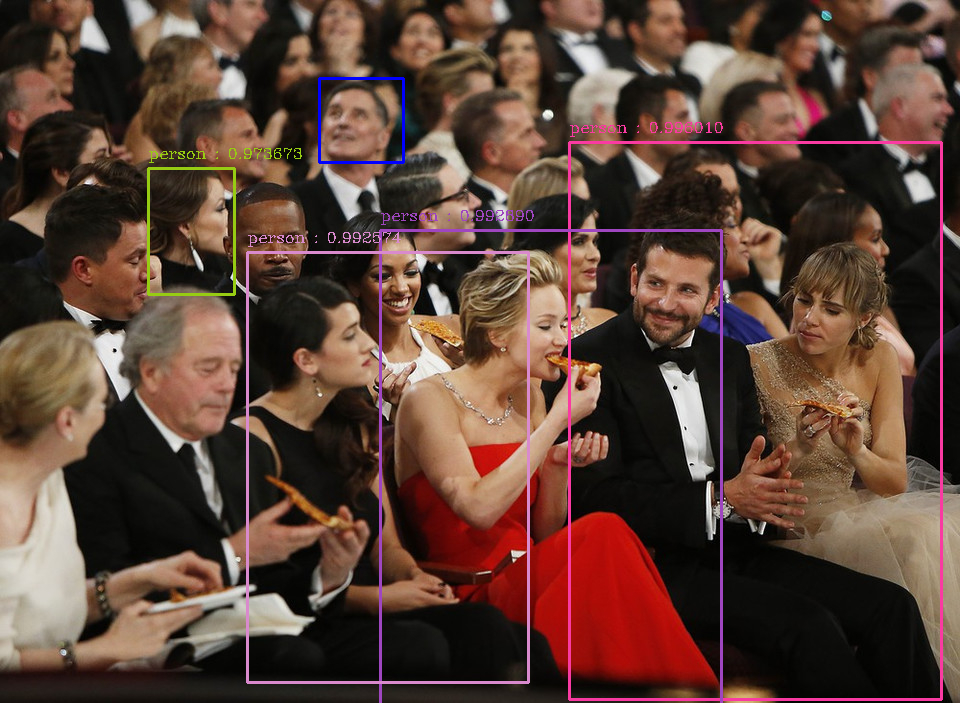

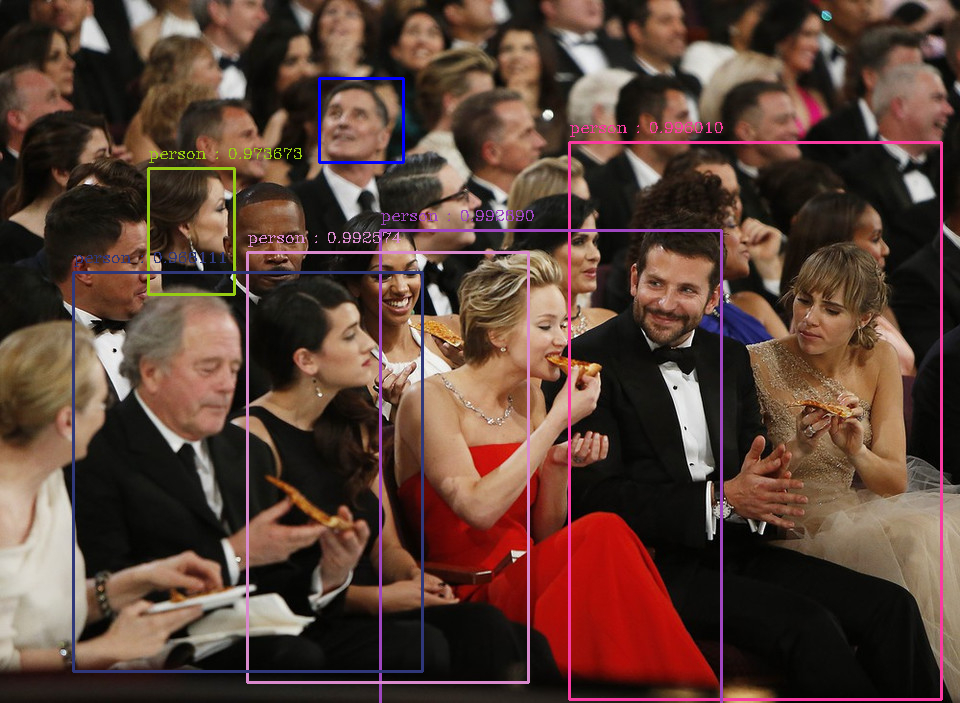

...

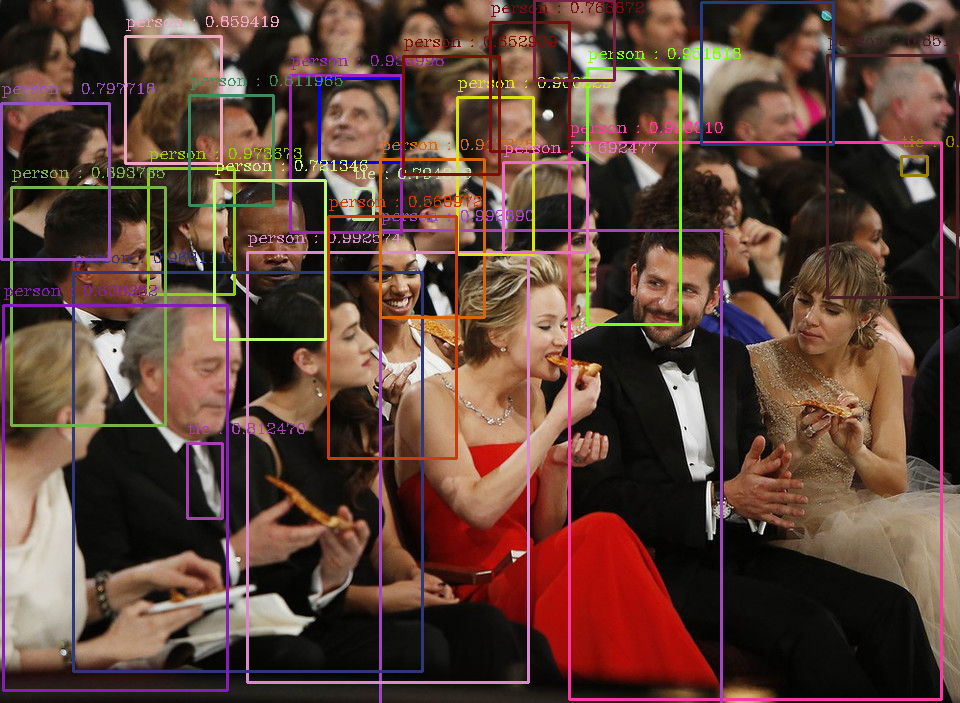

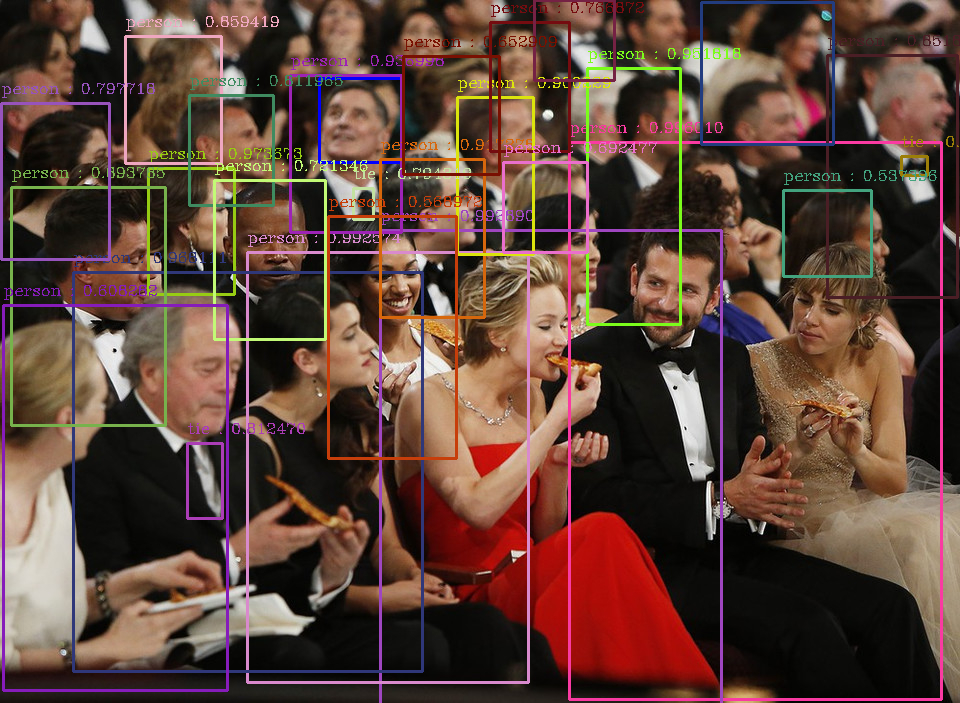

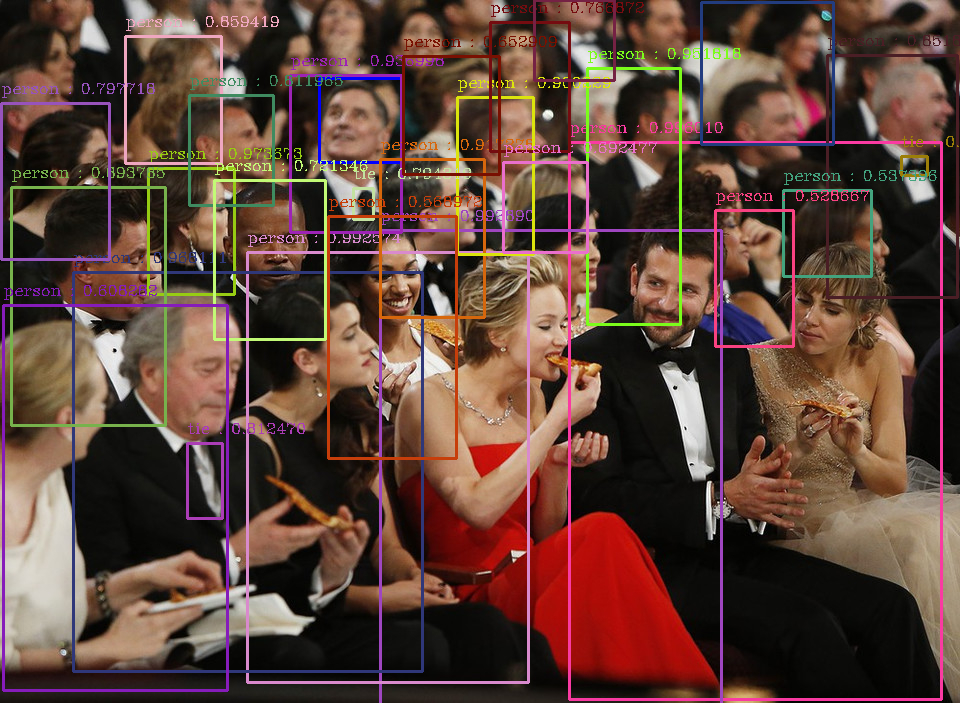

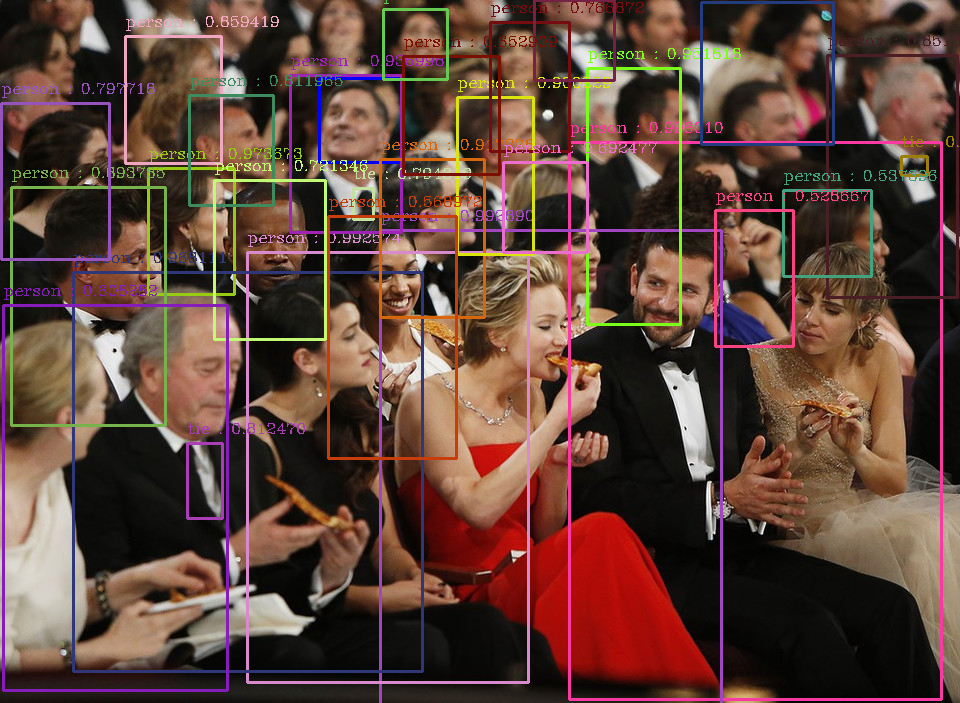

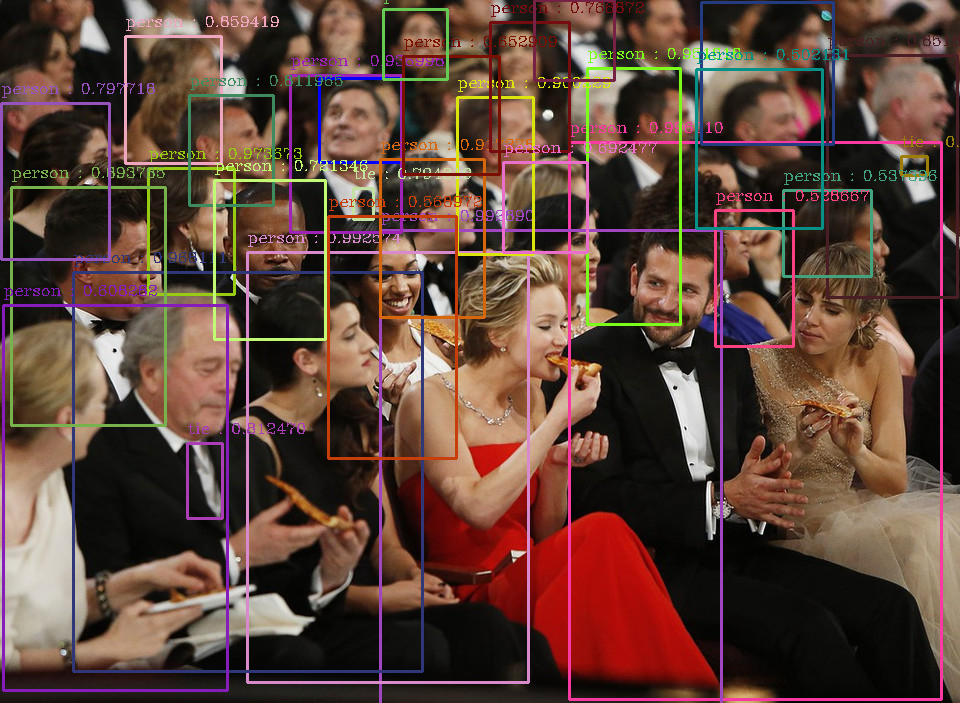

In [ ]:
class_ids = []
confidences = []
boxes = []

for out in outs: # outs : 3개의 레이어에 대한 분류 결과가 들어있다.
  for detection in out: # 각 레이어에서 탐색한 정보
    # detection[0, 1, 2, 3] -> [center_x, center_y, width, height]
    # detection[5:] # softmax 분류 결과 - confidence가 된다.
    scores = detection[5: ]
    class_id = np.argmax(scores) # 가장 높은 곳의 인덱스가 classes의 id가 된다.
    
    confidence = scores[ class_id ] # 해당 클래스의 confidence값

    if confidence > min_confidence:
      # print(class_id, confidence)
      center_x = int(detection[0] * width)
      center_y = int(detection[1] * height)

      w = int(detection[2] * width)
      h = int(detection[3] * height)

      # Rectangle Coordinates
      x = int(center_x - w / 2)
      y = int(center_y - h / 2)

      # 클래스별 사각형 좌표, confidence, id 모으기
      boxes.append([x, y, w, h])
      confidences.append(confidence.astype('float'))
      class_ids.append(class_id)

# NMS : None Maximum Suppresion 

# 탐지된 여러 개의 박스 중 하나만 선택된 것을 리턴 
indexes = cv2.dnn.NMSBoxes(boxes, # 감지된 박스 좌표
                           confidences, # 감지된 박스의 confidence
                           min_confidence, # 최소 confidence
                           0.4) # IoU가 0.4 이상인 것만 같은 박스로 치겠다.

frame = img.copy()

for i in indexes:
    idx = i[0]
    x, y, w, h = boxes[idx]

    label = "{} : {:3f}".format(str(classes[class_ids[idx]]), confidences[idx])

    color = colors[idx]

    cv2.rectangle(frame, (x, y), (x+w, y+h), color, 2)
    cv2.putText(frame, label, (x, y -10), cv2.FONT_HERSHEY_COMPLEX, 0.5, color, 1)

    cv2_imshow(frame)